In [1]:
import torch
import torchvision
import torchvision.transforms as transforms
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from PIL import Image, ImageDraw, ImageOps
import scipy.io as sio
import cv2
from sklearn.metrics import roc_auc_score
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import time
import sys
from convNet import sumNet
from face_dataset import picDataset
from torch.autograd import Variable
import os
from my_resnet18 import resnet18

root_path = "/local_scratch/vsushko/pycharm_proj/heatmaps_resnet/"
path_test = root_path+"test"
data_descr_path = root_path+"data_descript"
path_train = root_path+"train"
model_path = root_path+"model"
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
sigma = 20
size_of_train = 10
num_of_epoch = 100

net = sumNet()
net.load_state_dict(torch.load("trained_model3-020.ptch", map_location='cpu'))

net = net.to(device)
net.train()
criterion = nn.BCELoss()
optimizer = optim.Adam(net.parameters(), lr=0.00001, betas=(0.9, 0.999), eps=1e-08, weight_decay=0, amsgrad=False)
# optimizer = optim.SGD(net.parameters(), lr=0.0001, momentum=0.9)





In [2]:
print(sum(p.numel() for p in net.parameters() if p.requires_grad))

def mask_predict(output):
    output = np.array(output.detach().numpy())
    size = output.shape
    listx = np.linspace(0, size[0]-1, num=14, endpoint=True)
    listy = np.linspace(0, size[1]-1, num=14, endpoint=True)
    listx = list(map(int, (map(round, listx))))
    listy = list(map(int, (map(round, listy))))
    answer = np.zeros((13, 13))
    for i in range(13):
        for j in range(13):
            answer[i, j] = np.mean(output[ listx[i]:listx[i+1], listy[j]:listy[j+1] ])
    return answer

21013001


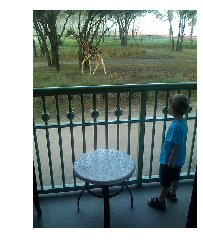

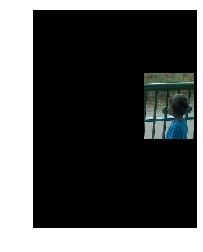

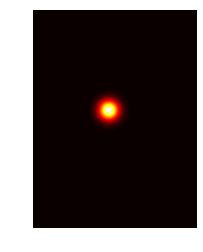

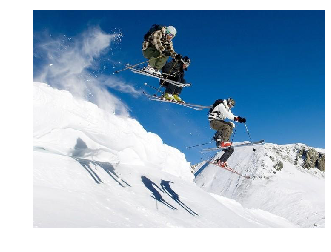

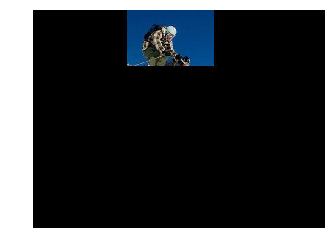

...

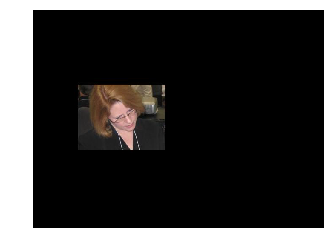

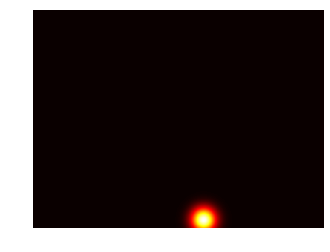

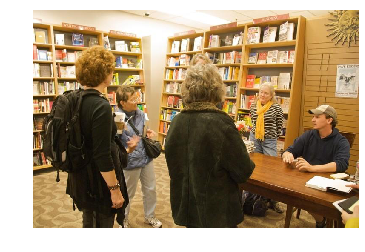

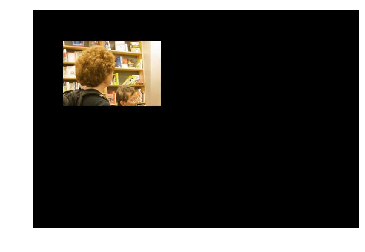

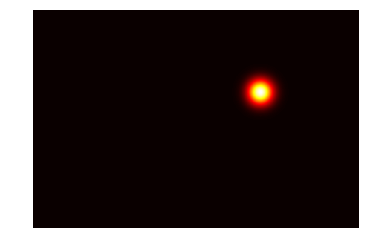

In [8]:
# Data

def gen_gauss(pic, gaze):
    sigma = 20
    x_grid, y_grid = np.meshgrid(np.linspace(1, pic.shape[1], pic.shape[1]), np.linspace(1,pic.shape[0], pic.shape[0]))
    mu = np.array([gaze[0]*pic.shape[1], gaze[1]*pic.shape[0]])
    d = np.sqrt((x_grid-mu[0])*(x_grid-mu[0])+(y_grid-mu[1])*(y_grid-mu[1]))
    g = np.exp(-( (d)**2 / ( 2.0 * sigma**2 ) ) )
    #g = 1*(d < 20)
    g = g/np.max(g)
    return g

root_folder = '/local_scratch/vsushko/AAnaconda/02-25 transfer from caffe/'
mode = 'train'
image_mean = sio.loadmat('/local_scratch/vsushko/AAnaconda/02-25 transfer from caffe/model/places_mean_resize.mat')['image_mean']
description = pd.read_csv('/local_scratch/vsushko/AAnaconda/02-25 transfer from caffe/data_descript/'+mode+'_annotations.txt', header=None)
criterion = nn.BCELoss()

for idx in range(1150, 1200):

    img_path = description.iloc[idx, 0]
    gaze = (description.iloc[idx, 8], description.iloc[idx, 9])
    eyes = (description.iloc[idx, 6], description.iloc[idx, 7])
    image = cv2.imread(root_folder+img_path)
    pic = Image.open(root_folder+img_path)
    face = cv2.imread('/local_scratch/vsushko/AAnaconda/03-06_heatmaps/generated_data/'+mode+'_face/'+'face'+str(idx)+'.jpg')
    face_pic = Image.open('/local_scratch/vsushko/AAnaconda/03-06_heatmaps/generated_data/'+mode+'_face/'+'face'+str(idx)+'.jpg')
    ground_truth = gen_gauss(image, gaze)
    
    plt.imshow(pic)
    plt.axis("off")
    plt.show()
    
    
    abc = np.array(face_pic)
    abcd = np.zeros(abc.shape)
    abcd[:, :, 0] = abc[:, :, 2]
    abcd[:, :, 1] = abc[:, :, 1]
    abcd[:, :, 2] = abc[:, :, 0]
    plt.imshow(Image.fromarray(np.uint8(abcd)))
    plt.axis("off")
    plt.show()
    
    
    plt.imshow(ground_truth, cmap='hot')
    plt.axis("off")
    plt.show()
    


/home/vsushko/anaconda3/lib/python3.6/site-packages/torch/nn/functional.py:1332: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


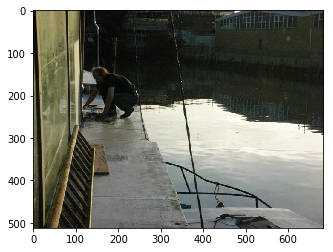

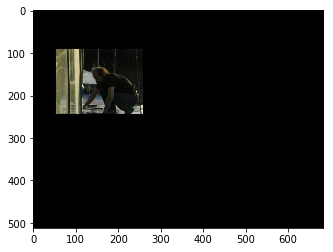

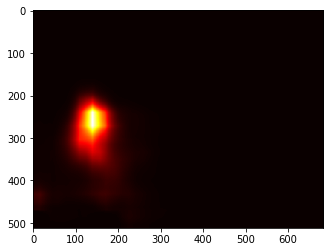

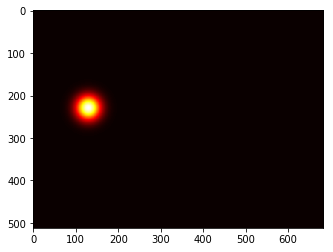

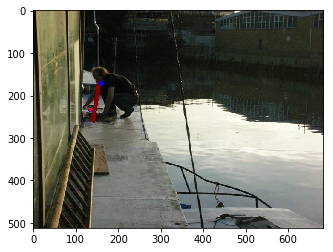

0.9880952380952381
0.02351468987762928
-----------------------------------------


/home/vsushko/anaconda3/lib/python3.6/site-packages/torch/nn/functional.py:1332: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


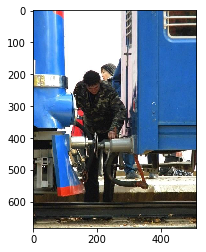

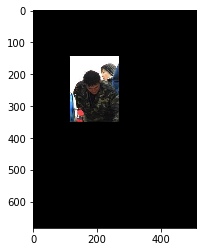

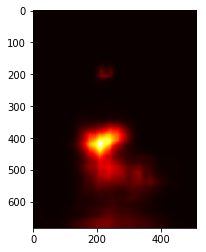

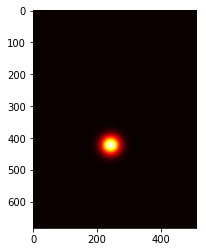

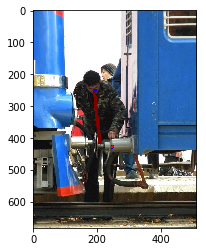

0.9583333333333334
0.024583104997873306
-----------------------------------------


/home/vsushko/anaconda3/lib/python3.6/site-packages/torch/nn/functional.py:1332: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


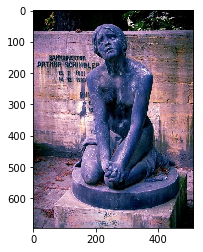

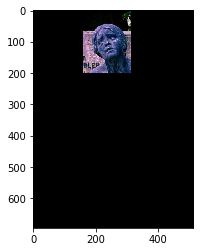

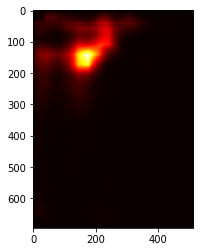

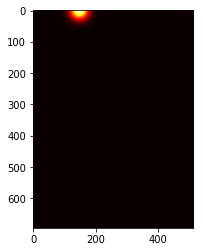

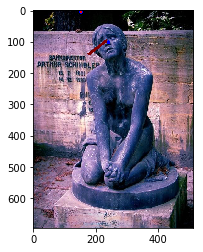

0.8690476190476191
0.029299065470695496
-----------------------------------------


/home/vsushko/anaconda3/lib/python3.6/site-packages/torch/nn/functional.py:1332: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


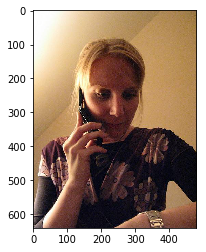

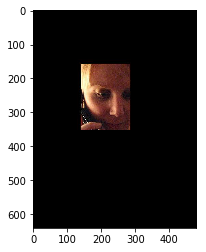

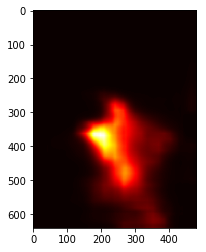

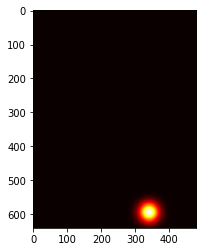

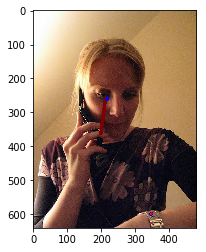

0.8809523809523809
0.04183777794241905
-----------------------------------------


/home/vsushko/anaconda3/lib/python3.6/site-packages/torch/nn/functional.py:1332: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


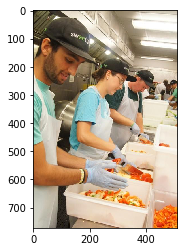

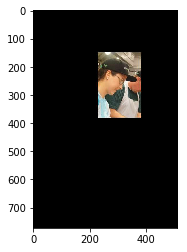

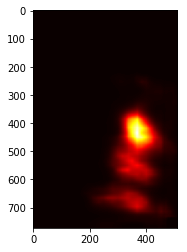

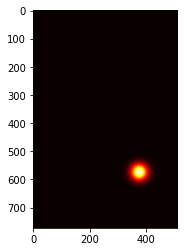

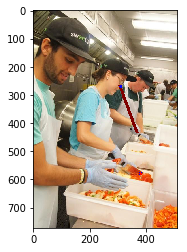

0.9642857142857143
0.027324985712766647
-----------------------------------------


/home/vsushko/anaconda3/lib/python3.6/site-packages/torch/nn/functional.py:1332: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


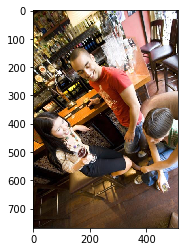

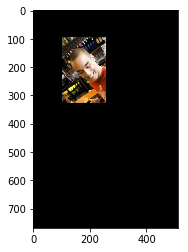

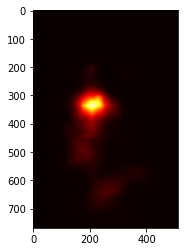

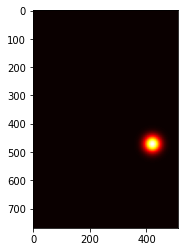

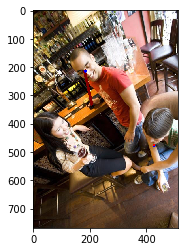

0.47023809523809523
0.06404435634613037
-----------------------------------------


/home/vsushko/anaconda3/lib/python3.6/site-packages/torch/nn/functional.py:1332: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


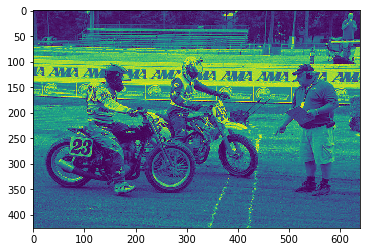

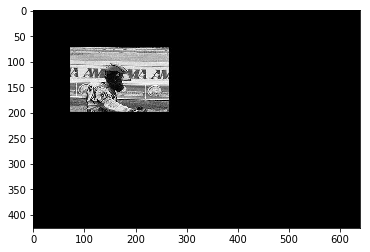

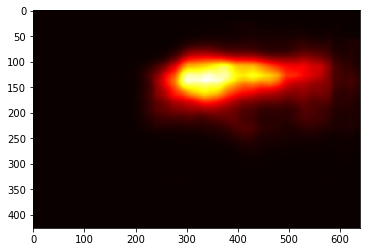

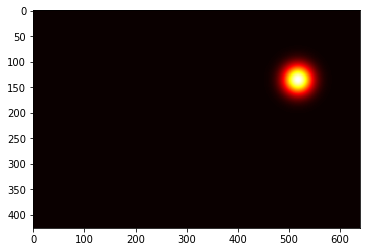

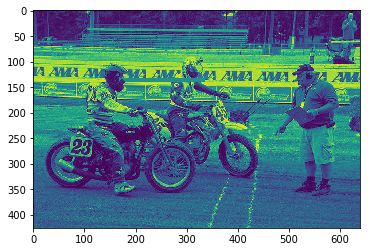

0.9226190476190477
0.038942623883485794
-----------------------------------------


/home/vsushko/anaconda3/lib/python3.6/site-packages/torch/nn/functional.py:1332: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


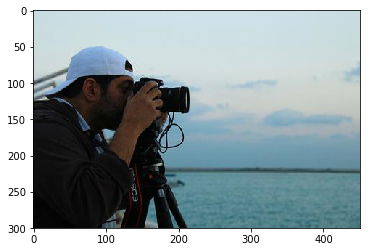

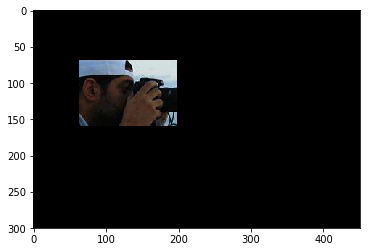

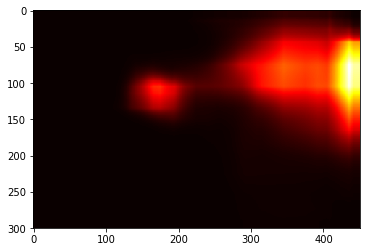

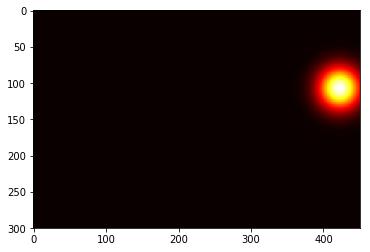

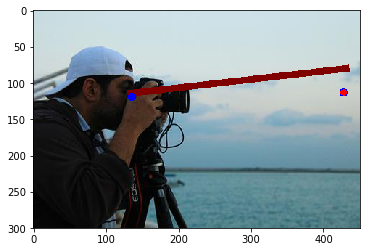

0.9940476190476191
0.05393843352794647
-----------------------------------------


/home/vsushko/anaconda3/lib/python3.6/site-packages/torch/nn/functional.py:1332: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


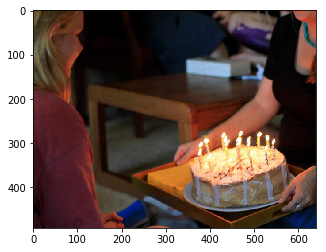

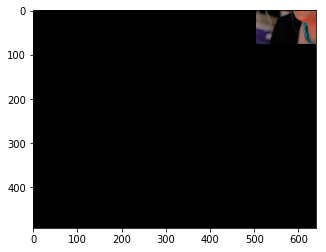

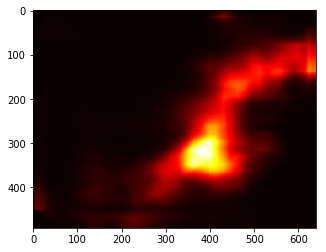

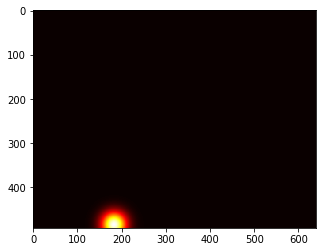

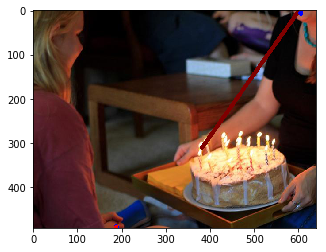

0.6607142857142857
0.03620535507798195
-----------------------------------------


/home/vsushko/anaconda3/lib/python3.6/site-packages/torch/nn/functional.py:1332: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


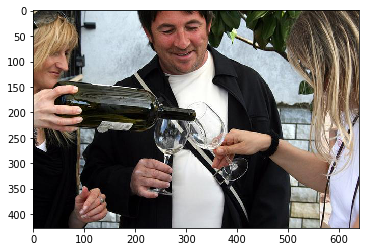

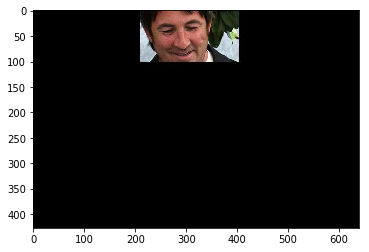

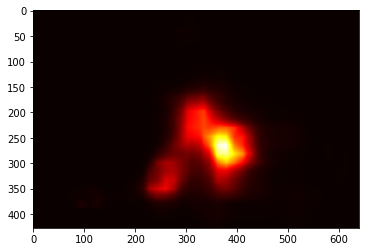

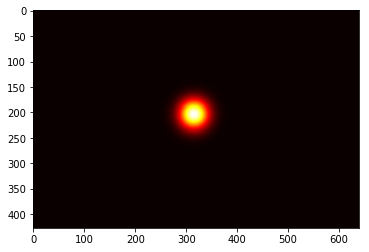

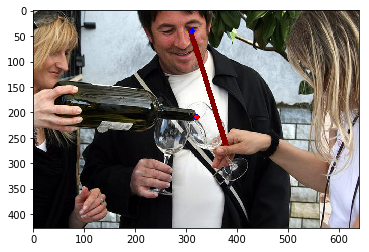

0.9880952380952381
0.03420429676771164
-----------------------------------------


/home/vsushko/anaconda3/lib/python3.6/site-packages/torch/nn/functional.py:1332: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


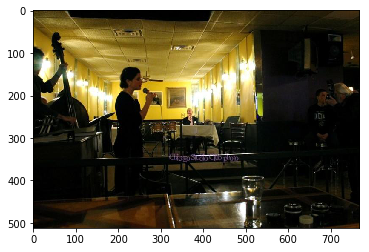

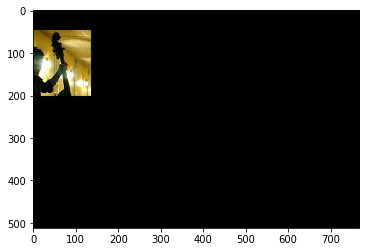

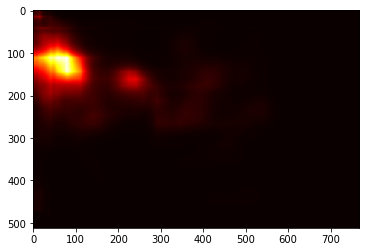

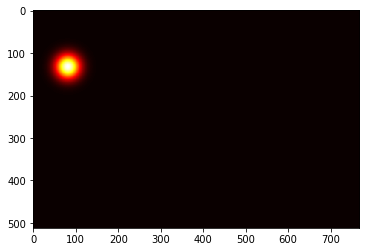

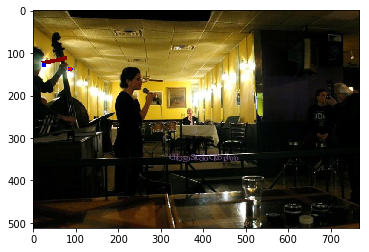

1.0
0.019056392833590508
-----------------------------------------


/home/vsushko/anaconda3/lib/python3.6/site-packages/torch/nn/functional.py:1332: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


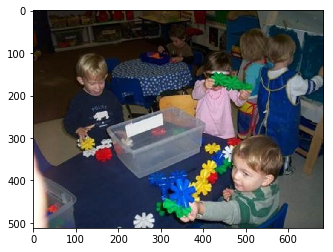

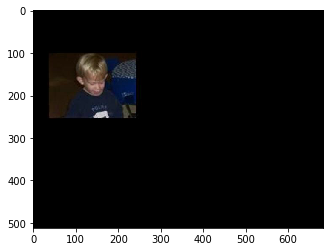

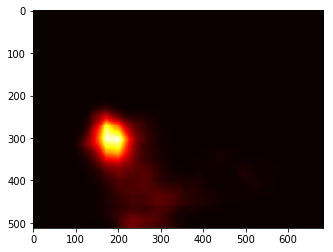

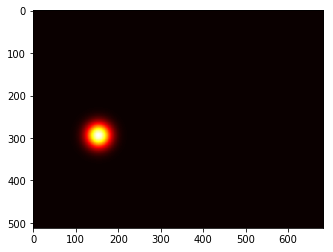

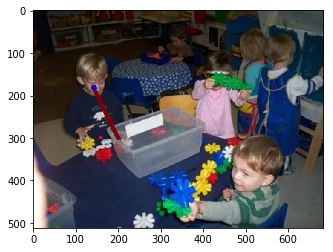

0.9702380952380952
0.023611219599843025
-----------------------------------------


/home/vsushko/anaconda3/lib/python3.6/site-packages/torch/nn/functional.py:1332: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


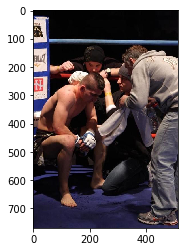

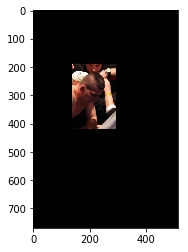

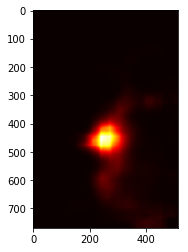

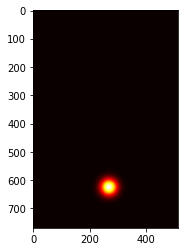

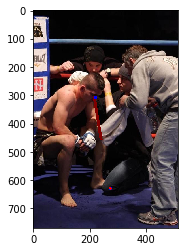

0.9404761904761905
0.032156094908714294
-----------------------------------------


/home/vsushko/anaconda3/lib/python3.6/site-packages/torch/nn/functional.py:1332: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


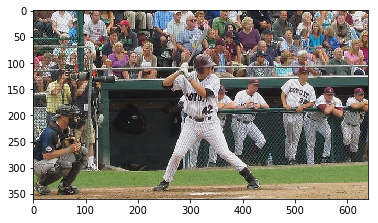

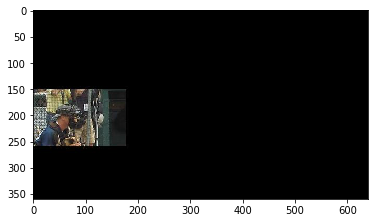

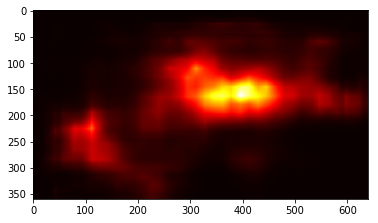

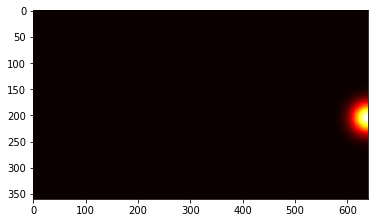

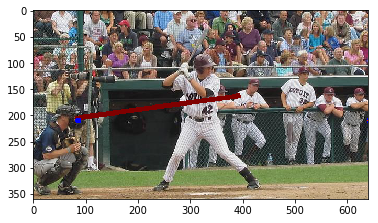

0.5357142857142857
0.044230327010154724
-----------------------------------------


/home/vsushko/anaconda3/lib/python3.6/site-packages/torch/nn/functional.py:1332: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


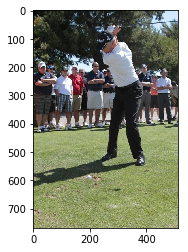

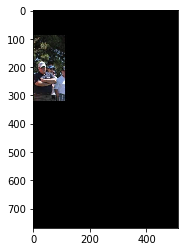

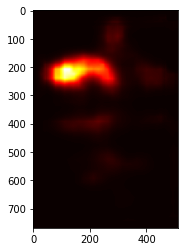

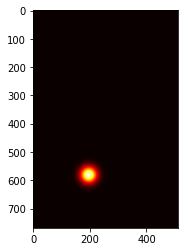

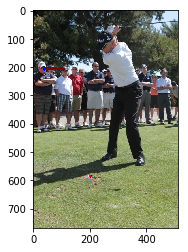

0.75
0.04342706874012947
-----------------------------------------


/home/vsushko/anaconda3/lib/python3.6/site-packages/torch/nn/functional.py:1332: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


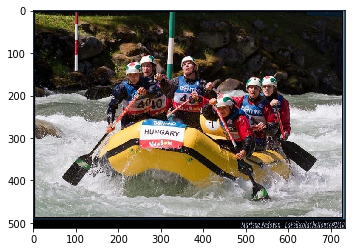

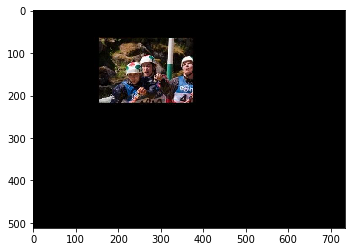

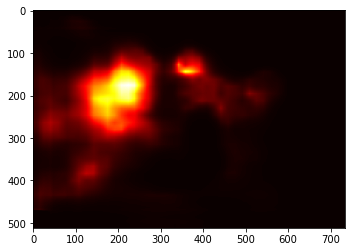

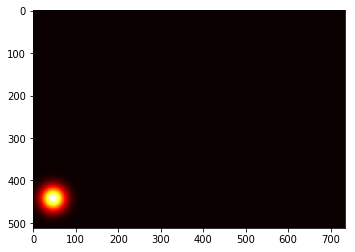

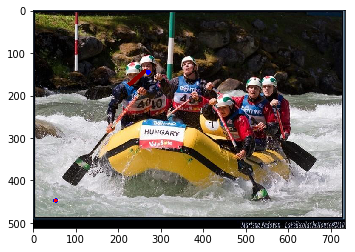

0.7083333333333333
0.044787850230932236
-----------------------------------------


/home/vsushko/anaconda3/lib/python3.6/site-packages/torch/nn/functional.py:1332: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


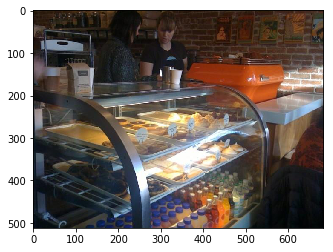

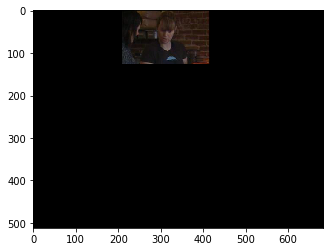

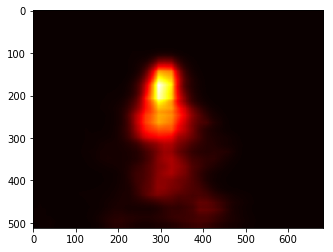

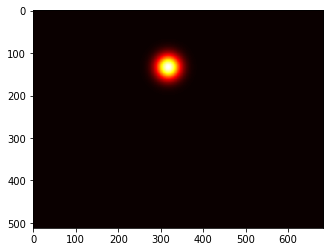

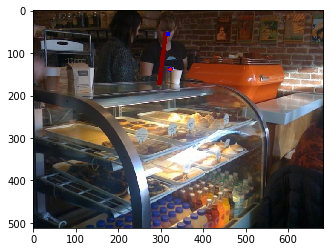

0.9464285714285714
0.031927671283483505
-----------------------------------------


/home/vsushko/anaconda3/lib/python3.6/site-packages/torch/nn/functional.py:1332: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


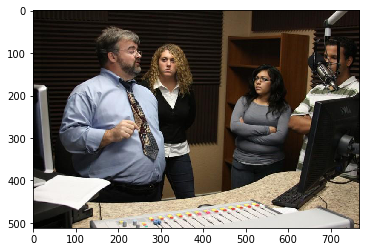

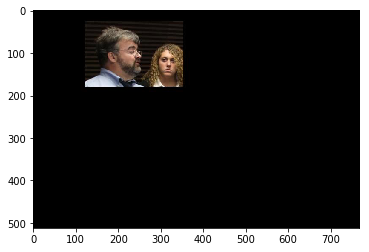

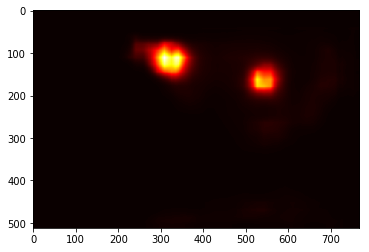

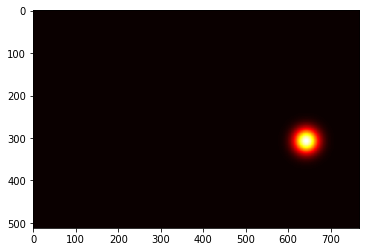

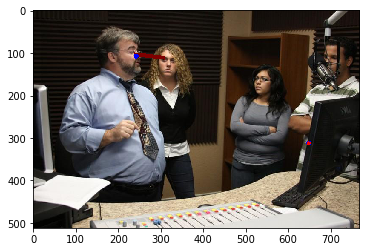

0.6964285714285714
0.05198328569531441
-----------------------------------------


/home/vsushko/anaconda3/lib/python3.6/site-packages/torch/nn/functional.py:1332: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


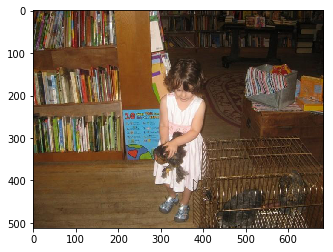

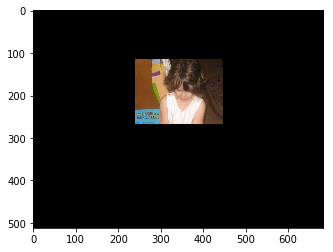

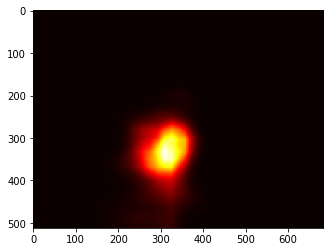

KeyboardInterrupt: 

In [3]:
# Data

def gen_gauss(pic, gaze):
    sigma = 20
    x_grid, y_grid = np.meshgrid(np.linspace(1, pic.shape[1], pic.shape[1]), np.linspace(1,pic.shape[0], pic.shape[0]))
    mu = np.array([gaze[0]*pic.shape[1], gaze[1]*pic.shape[0]])
    d = np.sqrt((x_grid-mu[0])*(x_grid-mu[0])+(y_grid-mu[1])*(y_grid-mu[1]))
    g = np.exp(-( (d)**2 / ( 2.0 * sigma**2 ) ) )
    #g = 1*(d < 20)
    g = g/np.max(g)
    return g

root_folder = '/local_scratch/vsushko/AAnaconda/02-25 transfer from caffe/'
mode = 'train'
image_mean = sio.loadmat('/local_scratch/vsushko/AAnaconda/02-25 transfer from caffe/model/places_mean_resize.mat')['image_mean']
description = pd.read_csv('/local_scratch/vsushko/AAnaconda/02-25 transfer from caffe/data_descript/'+mode+'_annotations.txt', header=None)
criterion = nn.BCELoss()

for idx in range(1000, 1020):

    img_path = description.iloc[idx, 0]
    gaze = (description.iloc[idx, 8], description.iloc[idx, 9])
    eyes = (description.iloc[idx, 6], description.iloc[idx, 7])
    image = cv2.imread(root_folder+img_path)
    pic = Image.open(root_folder+img_path)
    face = cv2.imread('/local_scratch/vsushko/AAnaconda/03-06_heatmaps/generated_data/'+mode+'_face/'+'face'+str(idx)+'.jpg')
    face_pic = Image.open('/local_scratch/vsushko/AAnaconda/03-06_heatmaps/generated_data/'+mode+'_face/'+'face'+str(idx)+'.jpg')
    ground_truth = gen_gauss(image, gaze)
    
    image_mean_tmp = cv2.resize(image_mean, (image.shape[1], image.shape[0]), interpolation=cv2.INTER_CUBIC)
    image = image - image_mean_tmp
    image = np.transpose(image, (2, 0, 1))

    face = np.transpose(face, (2, 0, 1))
    
    dim = image.shape
    image = torch.tensor(image).view(1, 3, dim[1], dim[2]).float(),
    face = torch.tensor(face).view(1, 3, dim[1], dim[2]).float(),
    ground_truth = torch.tensor(ground_truth).view(1, 1, dim[1], dim[2]).float()
    image = image[0]
    face = face[0]
    #image = image.view(1, image.shape[0], image.shape[1], image.shape[2])
    #face = face.view(1, face.shape[0], face.shape[1], face.shape[2])
    #ground = ground_truth.view(1, 1, ground.shape[0], ground.shape[1])
    
    output = net(image, face)[0]
    loss = criterion(output[0, 0, :, :].view(-1), ground_truth.view(-1))
    plt.imshow(pic)
    plt.show()
    abc = np.array(face_pic)
    abcd = np.zeros(abc.shape)
    abcd[:, :, 0] = abc[:, :, 2]
    abcd[:, :, 1] = abc[:, :, 1]
    abcd[:, :, 2] = abc[:, :, 0]
    plt.imshow(Image.fromarray(np.uint8(abcd)))
    plt.show()
    #print(output.detach().numpy()[0, 0, 140, :])
    plt.imshow(output.detach().numpy()[0, 0, :, :], cmap='hot', interpolation='nearest')
    plt.show()
    plt.imshow(ground_truth[0, 0, :, :], cmap='hot', interpolation='nearest')
    plt.show()
    
    to_ind = np.argmax(output.detach().numpy()[0, 0, :, :])
    x_predict = int(to_ind / pic.size[0])
    y_predict = to_ind % pic.size[0]
    im = pic
    draw = ImageDraw.Draw(im) 
    draw.line((eyes[0]* pic.size[0],eyes[1]* pic.size[1],
               y_predict, x_predict), fill=128, width=10)
    draw.ellipse((eyes[0]* pic.size[0],eyes[1]* pic.size[1], eyes[0]* pic.size[0]+10,eyes[1]* pic.size[1]+10), fill = 'blue', outline ='blue')
    draw.ellipse((gaze[0]* pic.size[0],gaze[1]* pic.size[1], gaze[0]* pic.size[0]+10,gaze[1]* pic.size[1]+10), fill = 'red', outline ='blue')
    plt.imshow(im)
    plt.show()
    
    mask_gaze = np.zeros((169,1,1))
    ffx = int(np.floor(gaze[0]*13))
    ffy = int(np.floor(gaze[1]*13))
    mask_gaze[13*ffy+ffx,0,0] = 1
    answer = mask_predict(output[0, 0, :, :])

    print(roc_auc_score(mask_gaze.reshape(-1), answer.reshape(-1)))
    print(loss.item())
    print("-----------------------------------------")

# Numerical Testing

In [29]:
# Data

def gen_gauss(pic, gaze):
    sigma = 20
    x_grid, y_grid = np.meshgrid(np.linspace(1, pic.shape[1], pic.shape[1]), np.linspace(1,pic.shape[0], pic.shape[0]))
    mu = np.array([gaze[0]*pic.shape[1], gaze[1]*pic.shape[0]])
    d = np.sqrt((x_grid-mu[0])*(x_grid-mu[0])+(y_grid-mu[1])*(y_grid-mu[1]))
    g = np.exp(-( (d)**2 / ( 2.0 * sigma**2 ) ) )
    #g = 1*(d < 20)
    g = g/np.max(g)
    return g
    

root_folder = '/local_scratch/vsushko/AAnaconda/02-25 transfer from caffe/'
mode = 'test'
image_mean = sio.loadmat('/local_scratch/vsushko/AAnaconda/02-25 transfer from caffe/model/places_mean_resize.mat')['image_mean']
description = pd.read_csv('/local_scratch/vsushko/AAnaconda/02-25 transfer from caffe/data_descript/'+mode+'_annotations.txt', header=None)
criterion = nn.BCELoss()

summ_roc = 0
num_iter = 0
for idx in range(0, 10000):

    img_path = description.iloc[idx, 0]
    gaze = (description.iloc[idx, 8], description.iloc[idx, 9])
    eyes = (description.iloc[idx, 6], description.iloc[idx, 7])
    image = cv2.imread(root_folder+img_path)
    pic = Image.open(root_folder+img_path)
    face = cv2.imread('/local_scratch/vsushko/AAnaconda/03-06_heatmaps/generated_data/'+mode+'_face/'+'face'+str(idx)+'.jpg')
    face_pic = Image.open('/local_scratch/vsushko/AAnaconda/03-06_heatmaps/generated_data/'+mode+'_face/'+'face'+str(idx)+'.jpg')
    ground_truth = gen_gauss(image, gaze)
    
    image_mean_tmp = cv2.resize(image_mean, (image.shape[1], image.shape[0]), interpolation=cv2.INTER_CUBIC)
    image = image - image_mean_tmp
    image = np.transpose(image, (2, 0, 1))

    face = np.transpose(face, (2, 0, 1))
    
    dim = image.shape
    image = torch.tensor(image).view(1, 3, dim[1], dim[2]).float(),
    face = torch.tensor(face).view(1, 3, dim[1], dim[2]).float(),
    ground_truth = torch.tensor(ground_truth).view(1, 1, dim[1], dim[2]).float()
    image = image[0]
    face = face[0]
    #image = image.view(1, image.shape[0], image.shape[1], image.shape[2])
    #face = face.view(1, face.shape[0], face.shape[1], face.shape[2])
    #ground = ground_truth.view(1, 1, ground.shape[0], ground.shape[1])
    
    output = net(image, face)[0]
    loss = criterion(output[0, 0, :, :].view(-1), ground_truth.view(-1))
    
    to_ind = np.argmax(output.detach().numpy()[0, 0, :, :])
    x_predict = int(to_ind / pic.size[0])
    y_predict = to_ind % pic.size[0]
    
    mask_gaze = np.zeros((169,1,1))
    ffx = int(np.floor(gaze[0]*13))
    ffy = int(np.floor(gaze[1]*13))
    mask_gaze[13*ffy+ffx,0,0] = 1
    
    answer = mask_predict(output[0, 0, :, :])
    
    summ_roc += roc_auc_score(mask_gaze.reshape(-1), answer.reshape(-1))
    num_iter += 1
    print(roc_auc_score(mask_gaze.reshape(-1), answer.reshape(-1)))
    if idx % 100 == 0:
        print('---', idx, summ_roc/num_iter)
        
print("!!!", summ_roc/num_iter)

/home/vsushko/anaconda3/lib/python3.6/site-packages/torch/nn/functional.py:1332: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


0.9702380952380952
--- 0 0.9702380952380952
0.9940476190476191
0.9702380952380952
0.9940476190476191
0.9940476190476191
0.9702380952380952
0.9940476190476191
0.9940476190476191
0.9702380952380952
0.9940476190476191
0.9940476190476191
0.9940476190476191
0.9940476190476191
0.9940476190476191
0.9940476190476191
0.9940476190476191
0.9880952380952381
0.9940476190476191
0.9166666666666666
0.9166666666666666
1.0
0.7023809523809523
0.7678571428571428
0.9940476190476191
1.0
0.5952380952380952
0.9940476190476191
1.0
0.32738095238095233
0.875
0.22619047619047616
0.9404761904761905
0.8571428571428572
0.9226190476190477
0.9226190476190477
0.9821428571428571
0.9404761904761905
0.9404761904761905
0.9821428571428571
0.9821428571428571
0.9821428571428571
0.9821428571428571
0.9404761904761905
0.8214285714285714
0.9821428571428571
0.9404761904761905
0.9702380952380952
0.9285714285714286
0.9464285714285714
0.9702380952380952
0.9047619047619048
0.9464285714285714
0.9285714285714286
0.9464285714285714
0.946

0.49404761904761907
0.49404761904761907
0.7916666666666666
0.7916666666666666
0.9940476190476191
0.9642857142857143
0.9642857142857143
0.7916666666666666
0.7916666666666666
0.7916666666666666
0.9464285714285714
0.9702380952380952
0.9702380952380952
0.9702380952380952
0.9702380952380952
0.9702380952380952
0.8690476190476191
0.9702380952380952
0.9702380952380952
0.9702380952380952
0.8630952380952381
0.9761904761904762
0.875
1.0
0.8630952380952381
1.0
0.9761904761904762
0.9761904761904762
0.8630952380952381
0.9761904761904762
0.9285714285714286
0.8154761904761905
0.8154761904761905
0.8154761904761905
0.9404761904761905
0.8630952380952381
0.8154761904761905
0.9047619047619048
0.9285714285714286
--- 500 0.8608140861134869
0.8154761904761905
0.9702380952380952
0.40476190476190477
0.9880952380952381
0.6428571428571428
0.6428571428571428
1.0
0.6428571428571428
0.9702380952380952
0.9702380952380952
0.9464285714285714
0.9702380952380952
0.9464285714285714
0.9702380952380952
0.9702380952380952
0.

1.0
1.0
0.875
1.0
0.9583333333333334
0.8214285714285714
0.9166666666666666
0.9880952380952381
0.9761904761904762
0.8690476190476191
0.9166666666666666
0.9166666666666666
0.9166666666666666
0.9166666666666666
0.9761904761904762
0.9761904761904762
0.9761904761904762
0.8869047619047619
0.9761904761904762
0.9761904761904762
0.9761904761904762
0.9166666666666666
0.9166666666666666
0.9464285714285714
0.9940476190476191
0.8214285714285714
0.9345238095238095
0.9345238095238095
0.9404761904761905
0.9345238095238095
0.9345238095238095
0.8154761904761905
0.8154761904761905
0.8214285714285714
0.8154761904761905
0.8333333333333334
0.8333333333333334
0.7797619047619048
0.8333333333333334
0.8154761904761905
0.8154761904761905
0.11904761904761907
0.11904761904761907
0.9404761904761905
0.22023809523809523
0.4821428571428571
0.5714285714285714
0.32738095238095233
0.7321428571428572
0.9047619047619048
0.11904761904761907
0.6964285714285714
0.6904761904761905
0.5654761904761905
0.7023809523809523
0.595238

0.9940476190476191
0.9940476190476191
0.9761904761904762
0.9940476190476191
1.0
1.0
1.0
1.0
1.0
1.0
0.9940476190476191
1.0
1.0
1.0
0.9404761904761905
0.9404761904761905
0.9404761904761905
0.8690476190476191
0.9464285714285714
0.9404761904761905
--- 1400 0.8666428741375186
0.8690476190476191
0.9464285714285714
0.9404761904761905
0.7619047619047619
0.9047619047619048
0.9523809523809523
0.9523809523809523
0.8333333333333334
0.8690476190476191
0.9583333333333334
0.9047619047619048
0.9583333333333334
0.9047619047619048
0.8154761904761905
0.9523809523809523
0.7380952380952381
0.9880952380952381
1.0
0.9523809523809523
0.9285714285714286
0.9940476190476191
0.9940476190476191
0.9940476190476191
0.9464285714285714
0.9523809523809523
0.9880952380952381
0.9523809523809523
0.9523809523809523
0.9523809523809523
0.9940476190476191
0.9523809523809523
0.9464285714285714
0.9523809523809523
0.9404761904761905
0.7440476190476191
0.9880952380952381
0.9583333333333334
0.9404761904761905
0.9821428571428571
0

0.8392857142857143
0.8452380952380952
0.9642857142857143
0.9642857142857143
0.9761904761904762
0.8869047619047619
0.8154761904761905
0.9642857142857143
0.9523809523809523
0.9523809523809523
0.9523809523809523
0.9523809523809523
0.9523809523809523
0.9523809523809523
0.9523809523809523
0.9761904761904762
0.9523809523809523
0.9523809523809523
0.9940476190476191
0.9523809523809523
0.9642857142857143
0.9642857142857143
0.9940476190476191
0.8988095238095238
0.9940476190476191
0.9940476190476191
0.9642857142857143
0.9940476190476191
0.5654761904761905
0.9464285714285714
0.49404761904761907
0.44047619047619047
0.9464285714285714
0.9761904761904762
0.8333333333333334
0.9464285714285714
0.8511904761904762
--- 1900 0.8730336163923738
0.8511904761904762
0.8690476190476191
0.8511904761904762
0.8511904761904762
0.8392857142857143
0.8511904761904762
0.9761904761904762
0.8511904761904762
0.8511904761904762
0.9047619047619048
0.9047619047619048
0.9047619047619048
0.8333333333333334
0.9047619047619048
0

0.5476190476190477
0.5476190476190477
0.5476190476190477
0.9464285714285714
0.5476190476190477
0.38690476190476186
0.38690476190476186
0.38690476190476186
0.34523809523809523
0.38690476190476186
0.38690476190476186
0.38690476190476186
0.34523809523809523
0.38690476190476186
0.38690476190476186
0.2321428571428571
0.2321428571428571
0.2321428571428571
0.2321428571428571
0.2321428571428571
0.2321428571428571
0.2321428571428571
0.2321428571428571
0.7321428571428572
0.2321428571428571
0.9702380952380952
0.8511904761904762
0.9345238095238095
0.9404761904761905
0.8809523809523809
0.9464285714285714
0.9404761904761905
0.9880952380952381
0.9880952380952381
0.9642857142857143
0.9940476190476191
0.9583333333333334
0.9702380952380952
1.0
0.9880952380952381
0.9880952380952381
1.0
0.9523809523809523
0.9940476190476191
1.0
1.0
1.0
1.0
0.9523809523809523
1.0
--- 2400 0.8672353781162585
1.0
0.8333333333333334
0.7440476190476191
0.9464285714285714
0.9464285714285714
0.9464285714285714
0.9464285714285714

0.9702380952380952
0.9702380952380952
0.875
0.8630952380952381
0.875
0.9940476190476191
1.0
0.9523809523809523
1.0
0.9940476190476191
1.0
0.9523809523809523
0.9523809523809523
0.9523809523809523
0.9523809523809523
0.9940476190476191
0.7857142857142857
0.8095238095238095
0.5
0.9821428571428571
0.5
0.27976190476190477
0.31547619047619047
0.27976190476190477
0.31547619047619047
0.31547619047619047
0.375
0.45238095238095233
0.31547619047619047
0.31547619047619047
0.31547619047619047
0.4642857142857143
0.75
0.75
0.75
0.75
0.75
0.75
0.9226190476190477
0.75
0.75
0.9821428571428571
0.9880952380952381
0.6130952380952381
0.9821428571428571
0.9464285714285714
0.9166666666666666
0.9464285714285714
0.9464285714285714
1.0
0.9702380952380952
1.0
1.0
1.0
1.0
0.9702380952380952
0.9702380952380952
0.9702380952380952
1.0
1.0
0.9464285714285714
0.9702380952380952
0.8988095238095238
0.9404761904761905
0.9583333333333334
0.9702380952380952
0.9583333333333334
0.9583333333333334
1.0
0.9285714285714286
0.98809

0.22619047619047616
0.8095238095238095
0.8333333333333334
0.9761904761904762
0.3928571428571429
0.9702380952380952
0.8571428571428572
0.9226190476190477
0.45238095238095233
0.9047619047619048
0.8452380952380952
0.9047619047619048
0.9642857142857143
0.9642857142857143
0.9821428571428571
0.9226190476190477
0.9226190476190477
0.9880952380952381
0.9642857142857143
0.9523809523809523
0.9523809523809523
0.8869047619047619
0.9523809523809523
0.9523809523809523
0.9523809523809523
0.9523809523809523
0.9523809523809523
0.9523809523809523
0.9523809523809523
0.6964285714285714
0.875
0.5833333333333333
0.17261904761904767
0.45833333333333337
0.45833333333333337
0.8809523809523809
0.8809523809523809
0.8690476190476191
0.8809523809523809
0.9047619047619048
0.8809523809523809
0.8571428571428572
0.875
0.8035714285714286
0.6785714285714286
1.0
0.875
0.7976190476190477
0.7976190476190477
0.7976190476190477
0.5476190476190477
0.8690476190476191
0.7619047619047619
0.6071428571428572
0.48809523809523814
0.8

0.9583333333333334
0.9285714285714286
0.9583333333333334
0.9583333333333334
0.9583333333333334
0.8988095238095238
0.9583333333333334
0.9940476190476191
0.9047619047619048
0.9940476190476191
0.9940476190476191
0.9940476190476191
0.9047619047619048
0.9940476190476191
0.9940476190476191
0.5416666666666667
0.9940476190476191
0.9464285714285714
0.9464285714285714
0.9464285714285714
0.9464285714285714
0.9464285714285714
--- 3800 0.8577629947006413
0.9464285714285714
0.9464285714285714
0.9404761904761905
0.9464285714285714
0.9464285714285714
0.9345238095238095
0.8392857142857143
0.8690476190476191
0.8988095238095238
0.8095238095238095
0.8809523809523809
0.8333333333333334
0.9285714285714286
0.9345238095238095
0.875
0.9285714285714286
0.8392857142857143
0.9642857142857143
0.875
0.6071428571428572
0.875
0.875
0.875
0.875
0.9702380952380952
0.9285714285714286
0.8809523809523809
0.9285714285714286
0.8809523809523809
0.8809523809523809
0.9285714285714286
1.0
0.8809523809523809
0.8809523809523809
1

0.9464285714285714
0.8214285714285714
0.7440476190476191
0.9642857142857143
0.8214285714285714
0.8214285714285714
0.9523809523809523
0.8214285714285714
1.0
1.0
1.0
1.0
1.0
1.0
1.0
0.32738095238095233
0.32738095238095233
0.32738095238095233
0.49404761904761907
0.26190476190476186
0.6488095238095238
0.4642857142857143
0.49404761904761907
0.26190476190476186
0.26190476190476186
0.4285714285714286
0.5714285714285714
0.6011904761904762
0.7797619047619048
0.7440476190476191
0.38095238095238093
0.6011904761904762
0.6011904761904762
0.6011904761904762
0.7261904761904762
0.6547619047619048
0.7261904761904762
0.5773809523809523
0.7261904761904762
0.7261904761904762
0.6547619047619048
0.49404761904761907
0.7261904761904762
0.6130952380952381
0.7202380952380952
0.6130952380952381
0.8273809523809523
0.6785714285714286
0.2142857142857143
0.9940476190476191
0.6666666666666667
0.3571428571428571
0.6130952380952381
0.7440476190476191
0.7440476190476191
0.6607142857142857
0.7440476190476191
0.6904761904

0.9107142857142857
0.9107142857142857
0.9107142857142857
0.9107142857142857
0.9107142857142857
0.9107142857142857
0.9107142857142857
0.6428571428571428
0.9345238095238095
0.6428571428571428
0.6428571428571428
0.6428571428571428
0.6428571428571428
0.6428571428571428
0.6428571428571428
0.5892857142857143
0.9047619047619048
0.9285714285714286
0.9047619047619048
0.9047619047619048
0.9285714285714286
0.9642857142857143
0.9285714285714286
0.9702380952380952
0.9702380952380952
0.9523809523809523
--- 4700 0.836608978839352
0.9523809523809523
0.9464285714285714
0.9464285714285714
0.9523809523809523
0.9523809523809523
0.9464285714285714
0.875
0.9107142857142857
0.8988095238095238
0.9464285714285714
0.9821428571428571
0.9821428571428571
0.8988095238095238
0.8988095238095238
0.875
0.8988095238095238
0.8988095238095238
0.7380952380952381
0.34523809523809523
0.34523809523809523
0.9642857142857143
0.9642857142857143
0.8988095238095238
0.9107142857142857
0.9642857142857143
0.34523809523809523
0.386904

0.9940476190476191
0.3928571428571429
0.2678571428571429
0.19047619047619047
0.38690476190476186
0.38095238095238093
0.2678571428571429
0.33333333333333337
0.35119047619047616
0.2678571428571429
0.8095238095238095
0.5119047619047619
0.48809523809523814
0.30952380952380953
0.5119047619047619
0.48809523809523814
0.30952380952380953
0.48809523809523814
0.7678571428571428
0.48809523809523814
0.9047619047619048
0.9940476190476191
0.9940476190476191
0.7738095238095238
0.9880952380952381
0.8869047619047619
0.9940476190476191
0.8392857142857143
0.7916666666666666
0.8392857142857143
0.8809523809523809
0.8392857142857143
0.7916666666666666
0.8928571428571429
0.875
0.7916666666666666
0.13095238095238093
0.5
0.13095238095238093
0.13095238095238093
0.0535714285714286
0.13095238095238093
0.13095238095238093
0.9107142857142857
0.6130952380952381
0.6130952380952381
0.6130952380952381
0.6130952380952381
0.6130952380952381
0.6130952380952381
0.9404761904761905
0.6130952380952381
0.6130952380952381
0.25


0.27380952380952384
0.9047619047619048
0.4285714285714286
0.9047619047619048
0.8333333333333334
0.9940476190476191
0.9047619047619048
0.9880952380952381
--- 5600 0.8237177034713193
0.9702380952380952
0.9761904761904762
0.9464285714285714
0.9761904761904762
0.9880952380952381
0.8630952380952381
0.9761904761904762
0.9940476190476191
0.9761904761904762
0.7559523809523809
0.8392857142857143
0.7738095238095238
0.8988095238095238
0.8154761904761905
0.9226190476190477
0.9166666666666666
0.7559523809523809
0.9642857142857143
0.9642857142857143
0.9642857142857143
0.9702380952380952
0.9642857142857143
0.9880952380952381
0.9702380952380952
0.9940476190476191
0.8333333333333334
0.9642857142857143
0.9940476190476191
0.9583333333333334
0.9464285714285714
0.6309523809523809
0.9583333333333334
0.9583333333333334
0.43452380952380953
0.43452380952380953
0.9583333333333334
0.8928571428571429
0.9226190476190477
0.9404761904761905
0.5892857142857143
0.5892857142857143
0.5892857142857143
0.5892857142857143


0.7857142857142857
1.0
1.0
1.0
1.0
0.9880952380952381
1.0
0.9940476190476191
0.9940476190476191
0.9940476190476191
1.0
0.8035714285714286
0.7678571428571428
0.8511904761904762
0.9166666666666666
0.8511904761904762
0.7440476190476191
0.9166666666666666
0.9404761904761905
0.7678571428571428
0.8809523809523809
0.7321428571428572
0.8809523809523809
0.8035714285714286
0.8809523809523809
0.8809523809523809
0.5773809523809523
0.8809523809523809
0.8809523809523809
0.8809523809523809
0.9107142857142857
0.8928571428571429
0.8928571428571429
0.8928571428571429
0.8928571428571429
0.8928571428571429
0.9523809523809523
0.8928571428571429
0.8928571428571429
0.8928571428571429
0.8452380952380952
0.9940476190476191
0.9226190476190477
0.9226190476190477
0.7916666666666666
0.8452380952380952
0.9166666666666666
0.9166666666666666
0.6488095238095238
0.9166666666666666
0.9107142857142857
0.9107142857142857
0.9940476190476191
0.8511904761904762
0.8511904761904762
0.9107142857142857
0.8511904761904762
0.91071

0.9702380952380952
0.6666666666666667
0.7202380952380952
0.8095238095238095
0.6666666666666667
0.7202380952380952
0.7202380952380952
0.6428571428571428
0.6547619047619048
0.6547619047619048
0.6547619047619048
0.6547619047619048
0.6369047619047619
0.6547619047619048
0.6547619047619048
--- 6500 0.8224238395558214
0.6547619047619048
0.6547619047619048
0.8809523809523809
1.0
0.875
0.5178571428571428
0.5297619047619048
0.5357142857142857
0.5595238095238095
0.5178571428571428
0.4642857142857143
0.5297619047619048
0.9880952380952381
0.9880952380952381
0.9880952380952381
0.9880952380952381
0.9880952380952381
0.9880952380952381
0.8154761904761905
0.9880952380952381
0.9880952380952381
0.9880952380952381
0.9642857142857143
0.8869047619047619
0.9642857142857143
0.8511904761904762
0.9880952380952381
0.9880952380952381
0.9285714285714286
0.9642857142857143
0.9642857142857143
0.9642857142857143
0.9464285714285714
0.9523809523809523
0.9464285714285714
0.9464285714285714
0.9464285714285714
0.9523809523

0.5297619047619048
0.9285714285714286
0.9761904761904762
0.9761904761904762
0.9761904761904762
0.9761904761904762
0.9761904761904762
0.9761904761904762
0.9761904761904762
0.9761904761904762
0.9761904761904762
0.9940476190476191
0.33333333333333337
0.9464285714285714
0.9940476190476191
0.9940476190476191
0.9940476190476191
0.9940476190476191
0.9940476190476191
0.875
0.875
0.8035714285714286
0.875
0.8392857142857143
0.875
0.875
0.8035714285714286
0.875
0.875
1.0
1.0
1.0
0.9940476190476191
0.9940476190476191
0.9821428571428571
1.0
0.9940476190476191
1.0
1.0
1.0
1.0
1.0
1.0
0.9523809523809523
0.9583333333333334
1.0
1.0
1.0
0.9761904761904762
0.9761904761904762
0.9761904761904762
0.9940476190476191
1.0
0.9940476190476191
0.9761904761904762
0.9940476190476191
1.0
0.49404761904761907
--- 7000 0.8187027703525392
0.49404761904761907
0.5178571428571428
0.49404761904761907
0.49404761904761907
0.5178571428571428
0.5178571428571428
0.5178571428571428
0.49404761904761907
0.49404761904761907
0.916666

1.0
0.9166666666666666
1.0
0.9464285714285714
1.0
0.9464285714285714
0.9642857142857143
1.0
1.0
1.0
0.9166666666666666
0.9285714285714286
0.9166666666666666
0.9285714285714286
0.9166666666666666
0.9166666666666666
0.9880952380952381
0.9285714285714286
0.9226190476190477
0.9166666666666666
0.7559523809523809
0.15476190476190477
0.0892857142857143
0.0892857142857143
0.625
0.7559523809523809
0.7559523809523809
0.7559523809523809
0.7559523809523809
1.0
1.0
1.0
1.0
0.8928571428571429
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
0.9702380952380952
0.75
0.9642857142857143
0.9166666666666666
0.9642857142857143
0.9702380952380952
0.9702380952380952
0.9702380952380952
0.9047619047619048
0.8214285714285714
0.7559523809523809
0.9761904761904762
0.8392857142857143
0.9047619047619048
0.9047619047619048
0.8869047619047619
0.8869047619047619
0.8333333333333334
0.8869047619047619
0.8869047619047619
0.8452380952380952
0.8869047619047619
0.88690476190476

0.7440476190476191
0.47619047619047616
0.47619047619047616
0.8988095238095238
0.9226190476190477
0.9642857142857143
0.8988095238095238
0.9821428571428571
0.8988095238095238
0.9226190476190477
0.9761904761904762
0.9642857142857143
0.8988095238095238
0.7440476190476191
0.6845238095238095
0.8809523809523809
0.6607142857142857
0.9464285714285714
0.9285714285714286
0.8809523809523809
0.7440476190476191
0.8809523809523809
0.8809523809523809
0.8452380952380952
0.8392857142857143
0.8035714285714286
0.6488095238095238
0.8928571428571429
0.8392857142857143
0.8035714285714286
0.7321428571428572
0.8035714285714286
0.8035714285714286
0.9702380952380952
0.9821428571428571
0.9702380952380952
0.9761904761904762
0.9821428571428571
0.9702380952380952
0.9702380952380952
0.9702380952380952
0.9821428571428571
0.9702380952380952
0.9523809523809523
0.7202380952380952
0.8452380952380952
0.7321428571428572
0.9166666666666666
0.9523809523809523
0.8809523809523809
0.9523809523809523
0.4107142857142857
0.38095238

0.5297619047619048
0.47023809523809523
0.5297619047619048
0.9642857142857143
0.875
0.9821428571428571
0.9821428571428571
0.875
0.9821428571428571
0.9345238095238095
0.9821428571428571
0.9821428571428571
0.9821428571428571
0.0714285714285714
0.48809523809523814
0.0714285714285714
0.8035714285714286
0.5654761904761905
0.44047619047619047
0.6726190476190477
0.44047619047619047
0.48809523809523814
0.44047619047619047
0.9880952380952381
0.9880952380952381
0.9880952380952381
0.9880952380952381
0.9880952380952381
0.7261904761904762
0.9880952380952381
0.9880952380952381
0.9880952380952381
0.47619047619047616
0.3392857142857143
0.3392857142857143
0.3392857142857143
0.47619047619047616
0.3392857142857143
0.47619047619047616
0.47619047619047616
0.39880952380952384
0.3392857142857143
0.9940476190476191
0.9940476190476191
0.9642857142857143
0.8154761904761905
0.9642857142857143
0.9642857142857143
0.9642857142857143
0.9523809523809523
0.8392857142857143
0.9642857142857143
0.7976190476190477
0.869047

0.9940476190476191
1.0
0.7261904761904762
1.0
--- 8800 0.8055097905541125
1.0
1.0
1.0
1.0
1.0
1.0
0.9821428571428571
1.0
1.0
0.75
0.75
0.75
0.75
0.75
0.75
0.75
0.75
0.75
0.75
0.9940476190476191
0.9940476190476191
0.9940476190476191
0.9940476190476191
0.9940476190476191
0.9940476190476191
0.9761904761904762
0.9940476190476191
0.9940476190476191
0.9940476190476191
0.8333333333333334
0.7559523809523809
0.9940476190476191
0.8333333333333334
0.9226190476190477
0.8333333333333334
0.8333333333333334
0.9345238095238095
0.9880952380952381
0.9583333333333334
0.24404761904761907
0.9880952380952381
0.9761904761904762
0.9880952380952381
0.7916666666666666
0.9880952380952381
0.13095238095238093
0.20833333333333337
0.20833333333333337
0.20833333333333337
0.26190476190476186
0.20833333333333337
0.20833333333333337
0.20833333333333337
0.33333333333333337
0.20833333333333337
0.7440476190476191
0.7321428571428572
0.5357142857142857
0.6309523809523809
0.5714285714285714
0.7440476190476191
0.74404761904761

0.9523809523809523
0.9523809523809523
0.9523809523809523
0.9523809523809523
0.9523809523809523
0.5535714285714286
0.7023809523809523
0.14880952380952384
0.7023809523809523
0.16666666666666663
0.7023809523809523
0.5535714285714286
0.16666666666666663
0.9880952380952381
0.7023809523809523
0.7380952380952381
0.7380952380952381
0.7619047619047619
0.9642857142857143
0.7619047619047619
0.875
0.7619047619047619
0.875
0.9821428571428571
0.7619047619047619
0.9345238095238095
0.9642857142857143
0.9345238095238095
0.8690476190476191
0.9166666666666666
0.8690476190476191
0.9166666666666666
0.8988095238095238
0.9166666666666666
0.9166666666666666
0.6309523809523809
0.8452380952380952
0.8452380952380952
0.6309523809523809
0.7619047619047619
0.8452380952380952
0.3928571428571429
0.6309523809523809
0.6309523809523809
0.6309523809523809
0.5833333333333333
0.5833333333333333
0.5833333333333333
--- 9300 0.8024732363647624
0.5833333333333333
0.5833333333333333
0.4821428571428571
0.5833333333333333
0.68452

0.8452380952380952
0.8452380952380952
0.29761904761904767
0.8452380952380952
0.6011904761904762
0.8452380952380952
0.9583333333333334
0.9345238095238095
0.9761904761904762
0.9583333333333334
0.9940476190476191
0.9761904761904762
0.9583333333333334
0.7619047619047619
0.47619047619047616
0.7797619047619048
0.7797619047619048
0.7619047619047619
0.7619047619047619
0.9107142857142857
0.7797619047619048
0.7797619047619048
0.7797619047619048
0.5119047619047619
0.9880952380952381
0.9642857142857143
1.0
0.9642857142857143
1.0
0.9642857142857143
1.0
1.0
1.0
0.9880952380952381
0.9880952380952381
0.9880952380952381
0.9702380952380952
0.9464285714285714
0.9880952380952381
0.9880952380952381
0.9345238095238095
0.9880952380952381
1.0
1.0
1.0
1.0
1.0
0.8571428571428572
0.7678571428571428
0.875
1.0
1.0
0.9821428571428571
0.9821428571428571
0.9940476190476191
0.9940476190476191
0.7976190476190477
0.9821428571428571
0.9940476190476191
0.9821428571428571
0.9940476190476191
0.9821428571428571
0.82738095238

In [86]:
# Data

def gen_gauss(pic, gaze):
    sigma = 20
    x_grid, y_grid = np.meshgrid(np.linspace(1, pic.shape[1], pic.shape[1]), np.linspace(1,pic.shape[0], pic.shape[0]))
    mu = np.array([gaze[0]*pic.shape[1], gaze[1]*pic.shape[0]])
    d = np.sqrt((x_grid-mu[0])*(x_grid-mu[0])+(y_grid-mu[1])*(y_grid-mu[1]))
    g = np.exp(-( (d)**2 / ( 2.0 * sigma**2 ) ) )
    #g = 1*(d < 20)
    g = g/np.max(g)
    return g

def mask_predict(output):
    output = np.array(output.detach().numpy())
    size = output.shape
    listx = np.linspace(0, size[0]-1, num=14, endpoint=True)
    listy = np.linspace(0, size[1]-1, num=14, endpoint=True)
    listx = list(map(int, (map(round, listx))))
    listy = list(map(int, (map(round, listy))))
    answer = np.zeros((13, 13))
    for i in range(13):
        for j in range(13):
            answer[i, j] = np.mean(output[ listx[i]:listx[i+1], listy[j]:listy[j+1] ])
    return answer
    

root_folder = '/local_scratch/vsushko/AAnaconda/02-25 transfer from caffe/'
mode = 'train'
image_mean = sio.loadmat('/local_scratch/vsushko/AAnaconda/02-25 transfer from caffe/model/places_mean_resize.mat')['image_mean']
description = pd.read_csv('/local_scratch/vsushko/AAnaconda/02-25 transfer from caffe/data_descript/'+mode+'_annotations.txt', header=None)
criterion = nn.BCELoss()

summ_roc = 0
num_iter = 0
for idx in range(2000, 2020):

    img_path = description.iloc[idx, 0]
    gaze = (description.iloc[idx, 8], description.iloc[idx, 9])
    eyes = (description.iloc[idx, 6], description.iloc[idx, 7])
    image = cv2.imread(root_folder+img_path)
    pic = Image.open(root_folder+img_path)
    face = cv2.imread('/local_scratch/vsushko/AAnaconda/03-06_heatmaps/generated_data/'+mode+'_face/'+'face'+str(idx)+'.jpg')
    face_pic = Image.open('/local_scratch/vsushko/AAnaconda/03-06_heatmaps/generated_data/'+mode+'_face/'+'face'+str(idx)+'.jpg')
    ground_truth = gen_gauss(image, gaze)
    
    image_mean_tmp = cv2.resize(image_mean, (image.shape[1], image.shape[0]), interpolation=cv2.INTER_CUBIC)
    image = image - image_mean_tmp
    image = np.transpose(image, (2, 0, 1))

    face = np.transpose(face, (2, 0, 1))
    
    dim = image.shape
    image = torch.tensor(image).view(1, 3, dim[1], dim[2]).float(),
    face = torch.tensor(face).view(1, 3, dim[1], dim[2]).float(),
    ground_truth = torch.tensor(ground_truth).view(1, 1, dim[1], dim[2]).float()
    image = image[0]
    face = face[0]
    #image = image.view(1, image.shape[0], image.shape[1], image.shape[2])
    #face = face.view(1, face.shape[0], face.shape[1], face.shape[2])
    #ground = ground_truth.view(1, 1, ground.shape[0], ground.shape[1])
    
    output = net(image, face)[0]
    loss = criterion(output[0, 0, :, :].view(-1), ground_truth.view(-1))
    
    to_ind = np.argmax(output.detach().numpy()[0, 0, :, :])
    x_predict = int(to_ind / pic.size[0])
    y_predict = to_ind % pic.size[0]
    
    mask_gaze = np.zeros((169,1,1))
    ffx = int(np.floor(gaze[0]*13))
    ffy = int(np.floor(gaze[1]*13))
    mask_gaze[13*ffy+ffx,0,0] = 1
    
    answer = mask_predict(output[0, 0, :, :])
    
    summ_roc += roc_auc_score(mask_gaze.reshape(-1), answer.reshape(-1))
    num_iter += 1
    print(roc_auc_score(mask_gaze.reshape(-1), answer.reshape(-1)))
    if idx % 100 == 0:
        print('---', idx, summ_roc/num_iter)
        
print("!!!", summ_roc/num_iter)

/home/vsushko/anaconda3/lib/python3.6/site-packages/torch/nn/functional.py:1332: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


0.8154761904761905
--- 2000 0.8154761904761905
1.0
0.6666666666666667
0.9880952380952381
0.9880952380952381
0.9761904761904762
0.9940476190476191
0.9642857142857143
1.0
1.0
0.9940476190476191
0.9047619047619048
1.0
0.9940476190476191
0.9642857142857143
0.8273809523809523
0.8333333333333334
0.8273809523809523
0.9523809523809523
0.7976190476190477
!!! 0.9244047619047618


In [20]:
class mytestnormNet(nn.Module):
    def __init__(self):
        super(mytestnormNet, self).__init__()
        self.norm = nn.BatchNorm2d(3)
    def forward(self, x):
        x = self.norm(x)
        return x
    
test_net = mytestnormNet()
test_net.eval()

x = torch.ones(1, 3, 4, 4)
x[0, 1, 1, :] = 15
x = Variable(x)
print(x)
m = test_net(x)
print(x)

/home/vsushko/anaconda3/lib/python3.6/site-packages/torch/nn/functional.py:1332: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


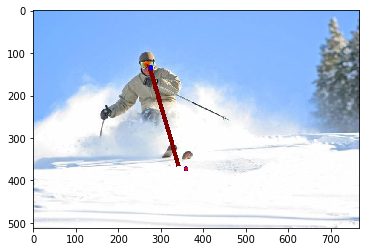

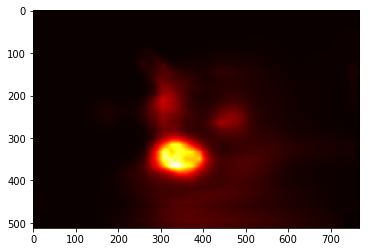

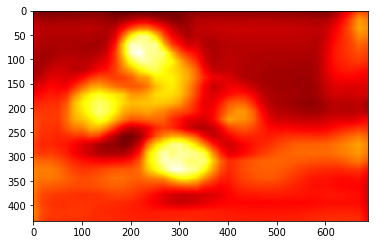

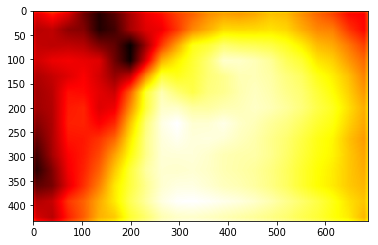

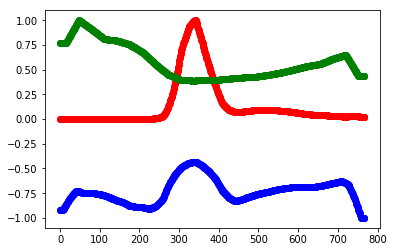

...

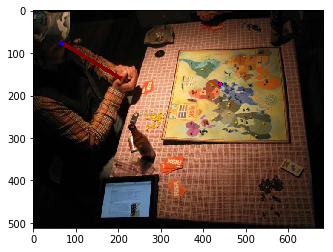

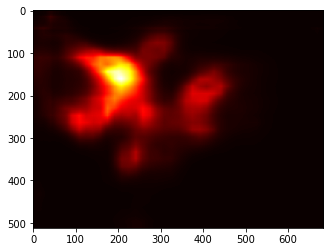

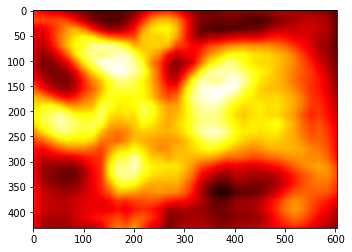

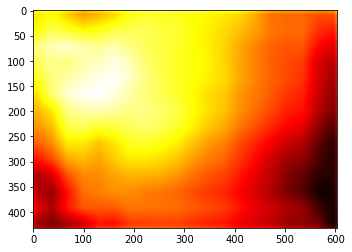

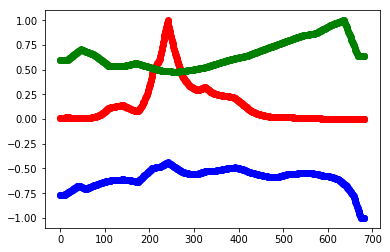

In [88]:
## This part runs only with out_data and out_eyes

root_folder = '/local_scratch/vsushko/AAnaconda/02-25 transfer from caffe/'
mode = 'train'
image_mean = sio.loadmat('/local_scratch/vsushko/AAnaconda/02-25 transfer from caffe/model/places_mean_resize.mat')['image_mean']
description = pd.read_csv('/local_scratch/vsushko/AAnaconda/02-25 transfer from caffe/data_descript/'+mode+'_annotations.txt', header=None)
criterion = nn.BCELoss()

def gen_gauss(pic, gaze):
    sigma = 20
    x_grid, y_grid = np.meshgrid(np.linspace(1, pic.shape[1], pic.shape[1]), np.linspace(1,pic.shape[0], pic.shape[0]))
    mu = np.array([gaze[0]*pic.shape[1], gaze[1]*pic.shape[0]])
    d = np.sqrt((x_grid-mu[0])*(x_grid-mu[0])+(y_grid-mu[1])*(y_grid-mu[1]))
    g = np.exp(-( (d)**2 / ( 2.0 * sigma**2 ) ) )
    #g = 1*(d < 20)
    g = g/np.max(g)
    return g

for idx in range(2000, 2020):
    img_path = description.iloc[idx, 0]
    gaze = (description.iloc[idx, 8], description.iloc[idx, 9])
    eyes = (description.iloc[idx, 6], description.iloc[idx, 7])
    image = cv2.imread(root_folder+img_path)
    pic = Image.open(root_folder+img_path)
    face = cv2.imread('/local_scratch/vsushko/AAnaconda/03-06_heatmaps/generated_data/'+mode+'_face/'+'face'+str(idx)+'.jpg')
    face_pic = Image.open('/local_scratch/vsushko/AAnaconda/03-06_heatmaps/generated_data/'+mode+'_face/'+'face'+str(idx)+'.jpg')
    ground_truth = gen_gauss(image, gaze)
    
    image_mean_tmp = cv2.resize(image_mean, (image.shape[1], image.shape[0]), interpolation=cv2.INTER_CUBIC)
    image = image - image_mean_tmp
    image = np.transpose(image, (2, 0, 1))

    face = np.transpose(face, (2, 0, 1))
    
    dim = image.shape
    image = torch.tensor(image).view(1, 3, dim[1], dim[2]).float(),
    face = torch.tensor(face).view(1, 3, dim[1], dim[2]).float(),
    ground_truth = torch.tensor(ground_truth).view(1, 1, dim[1], dim[2]).float()
    image = image[0]
    face = face[0]
    #image = image.view(1, image.shape[0], image.shape[1], image.shape[2])
    #face = face.view(1, face.shape[0], face.shape[1], face.shape[2])
    #ground = ground_truth.view(1, 1, ground.shape[0], ground.shape[1])
    
    output, out_data, out_eyes = net(image, face)
    loss = criterion(output[0, 0, :, :].view(-1), ground_truth.view(-1))
    
    
    to_ind = np.argmax(output.detach().numpy()[0, 0, :, :])
    x_predict = int(to_ind / pic.size[0])
    y_predict = to_ind % pic.size[0]
    im = pic
    draw = ImageDraw.Draw(im) 
    draw.line((eyes[0]* pic.size[0],eyes[1]* pic.size[1],
               y_predict, x_predict), fill=128, width=10)
    draw.ellipse((eyes[0]* pic.size[0],eyes[1]* pic.size[1], eyes[0]* pic.size[0]+10,eyes[1]* pic.size[1]+10), fill = 'blue', outline ='blue')
    draw.ellipse((gaze[0]* pic.size[0],gaze[1]* pic.size[1], gaze[0]* pic.size[0]+10,gaze[1]* pic.size[1]+10), fill = 'red', outline ='blue')
    plt.imshow(im)
    plt.show()
    plt.imshow(output.detach().numpy()[0, 0, :, :], cmap='hot', interpolation='nearest')
    plt.show()
    plt.imshow(out_data.detach().numpy()[0, 0, 40:-40, 40:-40], cmap='hot', interpolation='nearest')
    plt.show()
    plt.imshow(-out_eyes.detach().numpy()[0, 0, 40:-40, 40:-40], cmap='hot', interpolation='nearest')
    plt.show()

    #for i in range(output.shape[3]):
    #    print(i, float(out_data[0, 0,300, i]), float(out_eyes[0, 0,300, i]), float(output[0, 0,300, i]))
    rang = list(range(output.shape[3]))
    row = 320
    plt.plot(rang, list(map(float, output[0, 0, row, :]/torch.max(torch.abs(output[0, 0, row, :])))), 'ro')
    plt.plot(rang, list(map(float, out_data[0, 0, row, :]/torch.max(torch.abs(out_data[0, 0, row, :])))), 'bo')
    plt.plot(rang, list(map(float, out_eyes[0, 0, row, :]/torch.max(torch.abs(out_eyes[0, 0, row, :])))), 'go')
    plt.show()

# FUN PLAY

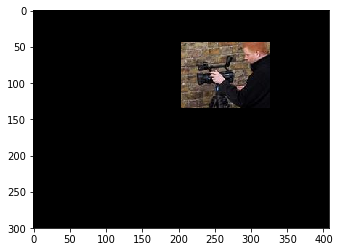

/home/vsushko/anaconda3/lib/python3.6/site-packages/torch/nn/functional.py:1332: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


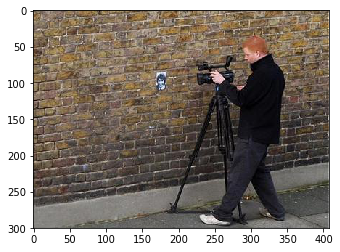

TypeError: Invalid dimensions for image data

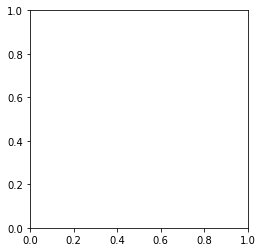

In [26]:
# Data

def gen_gauss(pic, gaze):
    sigma = 20
    x_grid, y_grid = np.meshgrid(np.linspace(1, pic.shape[1], pic.shape[1]), np.linspace(1,pic.shape[0], pic.shape[0]))
    mu = np.array([gaze[0]*pic.shape[1], gaze[1]*pic.shape[0]])
    d = np.sqrt((x_grid-mu[0])*(x_grid-mu[0])+(y_grid-mu[1])*(y_grid-mu[1]))
    g = np.exp(-( (d)**2 / ( 2.0 * sigma**2 ) ) )
    #g = 1*(d < 20)
    g = g/np.max(g)
    return g

root_folder = '/local_scratch/vsushko/AAnaconda/02-25 transfer from caffe/'
mode = 'train'
image_mean = sio.loadmat('/local_scratch/vsushko/AAnaconda/02-25 transfer from caffe/model/places_mean_resize.mat')['image_mean']
description = pd.read_csv('/local_scratch/vsushko/AAnaconda/02-25 transfer from caffe/data_descript/'+mode+'_annotations.txt', header=None)
criterion = nn.BCELoss()

def gen_face(pic, eyes):
    alpha = 0.3
    w_x = int(np.floor(alpha*pic.shape[1]))
    w_y = int(np.floor(alpha*pic.shape[0]))
    if w_x%2 == 0:
        w_x += 1
    if w_y%2 == 0:
        w_y += 1
    im_face = np.zeros((pic.shape[0], pic.shape[1], 3), dtype='uint8')
    center = np.floor([eyes[0]*pic.shape[1], eyes[1]*pic.shape[0]]).astype(int)
    d_x = int(np.floor((w_x-1)/2))
    d_y = int(np.floor((w_y-1)/2))
    tmp = center[0]-d_x
    img_l   = max(0, tmp)
    delta_l = max(0, -tmp)
    tmp = center[0]+d_x+1
    img_r   = min(pic.shape[1], tmp)
    delta_r = w_x-(tmp-img_r)
    tmp = center[1]-d_y
    img_t   = max(0, tmp)
    delta_t = max(0, -tmp)
    tmp = center[1]+d_y+1;
    img_b   = min(pic.shape[0], tmp)
    delta_b = w_y-(tmp-img_b)
    im_face[img_t:img_b,img_l:img_r,:] = pic[img_t:img_b,img_l:img_r,:]
    face_numpy = np.array(im_face)
    face_pic = Image.fromarray(face_numpy)
    return face_numpy

eyes_list = [(0.6, 0.3), (0.3, 0.3), (0.24, 0.4), (0.5, 0.55), (0.3, 0.2), (0.3, 0.5), (0.1, 0.5)]

for idx in range(1, 8):

    img_path = 'train/00000003/00003569.jpg'
    image = cv2.imread(root_folder+img_path)
    pic = Image.open(root_folder+img_path)
    eyes = (0.65196, 0.29667)
    face = gen_face(image, eyes)
    face = cv2.cvtColor(face,cv2.COLOR_BGR2RGB)
    plt.imshow(face)
    plt.show()
    #ground_truth = gen_gauss(image, gaze)
    
    image_mean_tmp = cv2.resize(image_mean, (image.shape[1], image.shape[0]), interpolation=cv2.INTER_CUBIC)
    image = image - image_mean_tmp
    image = np.transpose(image, (2, 0, 1))

    face = np.transpose(face, (2, 0, 1))

    dim = image.shape
    image = torch.tensor(image).view(1, 3, dim[1], dim[2]).float(),
    face = torch.tensor(face).view(1, 3, dim[1], dim[2]).float(),
    #ground_truth = torch.tensor(ground_truth).view(1, 1, dim[1], dim[2]).float()
    image = image[0]
    face = face[0]
    
    output = net(image, face)[0]
    #loss = criterion(output[0, 0, :, :].view(-1), ground_truth.view(-1))
    plt.imshow(pic)
    plt.show()
    plt.imshow(face)
    plt.show()
    #print(output.detach().numpy()[0, 0, 140, :])
    plt.imshow(output.detach().numpy()[0, 0, :, :], cmap='hot', interpolation='nearest')
    plt.show()
    #plt.imshow(ground_truth[0, 0, :, :], cmap='hot', interpolation='nearest')
    #plt.show()
    
    to_ind = np.argmax(output.detach().numpy()[0, 0, :, :])
    x_predict = int(to_ind / pic.size[0])
    y_predict = to_ind % pic.size[0]
    im = pic
    draw = ImageDraw.Draw(im) 
    draw.line((eyes[0]* pic.size[0],eyes[1]* pic.size[1],
               y_predict, x_predict), fill=128, width=10)
    draw.ellipse((eyes[0]* pic.size[0],eyes[1]* pic.size[1], eyes[0]* pic.size[0]+10,eyes[1]* pic.size[1]+10), fill = 'blue', outline ='blue')
    #draw.ellipse((gaze[0]* pic.size[0],gaze[1]* pic.size[1], gaze[0]* pic.size[0]+10,gaze[1]* pic.size[1]+10), fill = 'red', outline ='blue')
    plt.imshow(im)
    plt.show()
    
    print("-----------------------------------------")